/lib/python3.13/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 128028 (\N{ANT}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)


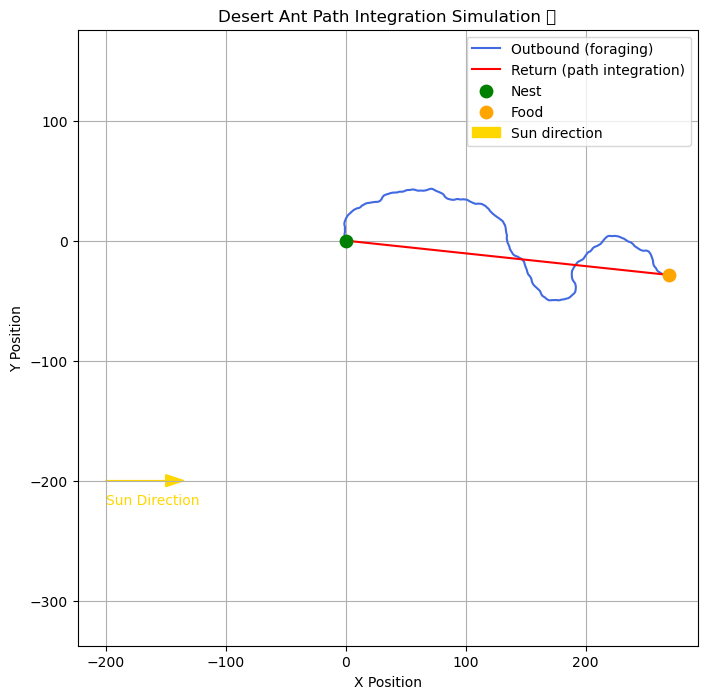

In [1]:
"""
Ant Navigation Simulation - Path Integration Inspired by Desert Ants 🐜
Author: [ASHWINIA]
Project: Bio-inspired strategies for multimodal navigation of autonomous vehicles
Supervisors: Dr. Ganga Prasath S & Dr. Danny Raj M, IIT Madras
"""

import numpy as np
import matplotlib.pyplot as plt

# Simulation Parameters

np.random.seed(42)  # For reproducibility
num_steps = 400     # Outbound wandering steps
step_size = 1.0     # Step length
sun_direction = 0.0  # 0 radians → East

# Nest and food
nest = np.array([0.0, 0.0])
food_distance = 150.0
food_direction = np.pi / 4   # 45° northeast


# Initialize Ant State

position = np.array([0.0, 0.0])
heading = np.pi / 2  # Start facing north
positions = [position.copy()]

# Path integration vector (displacement from nest)
path_vector = np.array([0.0, 0.0])


# Phase 1: Foraging (Random Walk)

for _ in range(num_steps):
    # Random small change in heading (simulate searching)
    heading += np.random.uniform(-0.3, 0.3)
    dx = step_size * np.cos(heading)
    dy = step_size * np.sin(heading)
    position += np.array([dx, dy])
    path_vector += np.array([dx, dy])  # internal integration
    positions.append(position.copy())

    # Check if food found
    if np.linalg.norm(position - food_distance * np.array([np.cos(food_direction),
                                                           np.sin(food_direction)])) < 5:
        print("Food found!")
        break

outbound_path = np.array(positions)
food_location = position.copy()


# Phase 2: Return to Nest

return_positions = [position.copy()]
return_steps = int(np.linalg.norm(path_vector) / step_size)

for _ in range(return_steps):
    # Move opposite to the integrated path vector direction
    return_heading = np.arctan2(-path_vector[1], -path_vector[0])
    dx = step_size * np.cos(return_heading)
    dy = step_size * np.sin(return_heading)
    position += np.array([dx, dy])
    return_positions.append(position.copy())

return_path = np.array(return_positions)


# Visualization

plt.figure(figsize=(8, 8))
plt.plot(outbound_path[:, 0], outbound_path[:, 1], color='royalblue', label='Outbound (foraging)')
plt.plot(return_path[:, 0], return_path[:, 1], color='red', label='Return (path integration)')
plt.scatter(nest[0], nest[1], color='green', s=80, label='Nest', zorder=5)
plt.scatter(food_location[0], food_location[1], color='orange', s=80, label='Food', zorder=5)

# Sun direction arrow
arrow_len = 50
plt.arrow(-200, -200, arrow_len * np.cos(sun_direction),
          arrow_len * np.sin(sun_direction), head_width=10, color='gold', label='Sun direction')
plt.text(-200, -220, "Sun Direction", color='gold')

plt.title("Desert Ant Path Integration Simulation 🐜")
plt.xlabel("X Position")
plt.ylabel("Y Position")
plt.legend()
plt.grid(True)
plt.axis('equal')
plt.show()


<ipython-input-7-2e951c22466d>:107: UserWarning: Glyph 128028 (\N{ANT}) missing from current font.
  ani = animation.FuncAnimation(fig, update, frames=frames, init_func=init,
<ipython-input-7-2e951c22466d>:99: MatplotlibDeprecationWarning: Setting data with a non sequence type is deprecated since 3.7 and will be remove two minor releases later
  ant_dot.set_data(outbound_path[frame, 0], outbound_path[frame, 1])
<ipython-input-7-2e951c22466d>:111: UserWarning: Glyph 128028 (\N{ANT}) missing from current font.
  HTML(ani.to_jshtml())
<ipython-input-7-2e951c22466d>:103: MatplotlibDeprecationWarning: Setting data with a non sequence type is deprecated since 3.7 and will be remove two minor releases later
  ant_dot.set_data(return_path[idx, 0], return_path[idx, 1])
Animation size has reached 21014653 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will

/lib/python3.13/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 128028 (\N{ANT}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)


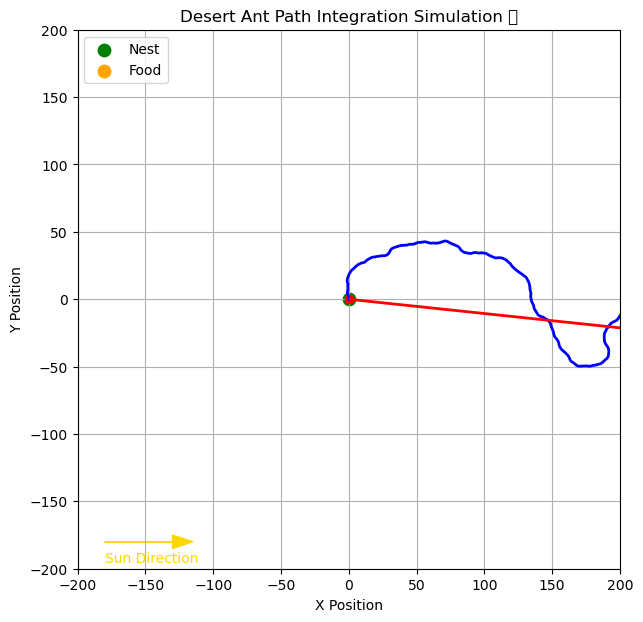

In [7]:
"""
Desert Ant Navigation Simulation 🐜
Bio-inspired path integration in 2D
Optimized for Jupyter Notebook (no ffmpeg required)
"""

import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML

# -----------------------------
# Simulation Parameters
# -----------------------------
np.random.seed(42)
num_steps = 400
step_size = 1.0
sun_direction = 0.0  # East (0 radians)

nest = np.array([0.0, 0.0])
food_distance = 150.0
food_direction = np.pi / 4  # 45° northeast

# -----------------------------
# Initialize Ant State
# -----------------------------
position = np.array([0.0, 0.0])
heading = np.pi / 2  # Facing north
positions = [position.copy()]
path_vector = np.array([0.0, 0.0])

# -----------------------------
# Phase 1: Foraging (Random Walk)
# -----------------------------
for _ in range(num_steps):
    heading += np.random.uniform(-0.3, 0.3)
    dx = step_size * np.cos(heading)
    dy = step_size * np.sin(heading)
    position += np.array([dx, dy])
    path_vector += np.array([dx, dy])
    positions.append(position.copy())

    # Simulated food check
    if np.linalg.norm(position - food_distance * np.array([np.cos(food_direction),
                                                           np.sin(food_direction)])) < 5:
        break

outbound_path = np.array(positions)
food_location = position.copy()

# -----------------------------
# Phase 2: Return to Nest
# -----------------------------
return_positions = [position.copy()]
return_steps = int(np.linalg.norm(path_vector) / step_size)

for _ in range(return_steps):
    return_heading = np.arctan2(-path_vector[1], -path_vector[0])
    dx = step_size * np.cos(return_heading)
    dy = step_size * np.sin(return_heading)
    position += np.array([dx, dy])
    return_positions.append(position.copy())

return_path = np.array(return_positions)
full_path = np.vstack((outbound_path, return_path))

# -----------------------------
# Animation Setup
# -----------------------------
fig, ax = plt.subplots(figsize=(7, 7))
ax.set_xlim(-200, 200)
ax.set_ylim(-200, 200)
ax.set_title("Desert Ant Path Integration Simulation 🐜")
ax.set_xlabel("X Position")
ax.set_ylabel("Y Position")
ax.grid(True)

ax.scatter(nest[0], nest[1], color='green', s=80, label='Nest')
ax.scatter(food_location[0], food_location[1], color='orange', s=80, label='Food')
arrow_len = 50
ax.arrow(-180, -180, arrow_len * np.cos(sun_direction),
         arrow_len * np.sin(sun_direction), head_width=10, color='gold')
ax.text(-180, -195, "Sun Direction", color='gold')
ax.legend(loc="upper left")

ant_dot, = ax.plot([], [], 'ro', markersize=6)
trail, = ax.plot([], [], 'b-', lw=2)
return_trail, = ax.plot([], [], 'r-', lw=2)

def init():
    ant_dot.set_data([], [])
    trail.set_data([], [])
    return_trail.set_data([], [])
    return ant_dot, trail, return_trail

def update(frame):
    if frame < len(outbound_path):
        trail.set_data(outbound_path[:frame, 0], outbound_path[:frame, 1])
        ant_dot.set_data(outbound_path[frame, 0], outbound_path[frame, 1])
    else:
        idx = frame - len(outbound_path)
        return_trail.set_data(return_path[:idx, 0], return_path[:idx, 1])
        ant_dot.set_data(return_path[idx, 0], return_path[idx, 1])
    return ant_dot, trail, return_trail

frames = len(full_path)
ani = animation.FuncAnimation(fig, update, frames=frames, init_func=init,
                              blit=True, interval=30, repeat=False)

# Show inline animation in Jupyter
HTML(ani.to_jshtml())


In [9]:
ani.save('ant_navigation.gif', writer='pillow', fps=30)


<ipython-input-7-2e951c22466d>:99: MatplotlibDeprecationWarning: Setting data with a non sequence type is deprecated since 3.7 and will be remove two minor releases later
  ant_dot.set_data(outbound_path[frame, 0], outbound_path[frame, 1])
<ipython-input-9-db8a23440197>:1: UserWarning: Glyph 128028 (\N{ANT}) missing from current font.
  ani.save('ant_navigation.gif', writer='pillow', fps=30)
<ipython-input-7-2e951c22466d>:103: MatplotlibDeprecationWarning: Setting data with a non sequence type is deprecated since 3.7 and will be remove two minor releases later
  ant_dot.set_data(return_path[idx, 0], return_path[idx, 1])


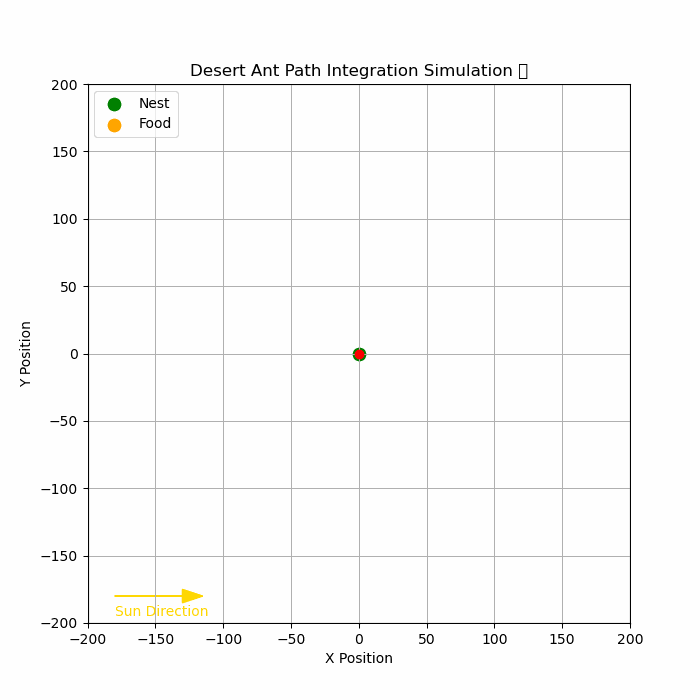

In [11]:
from IPython.display import Image
Image(filename='ant_navigation.gif')



In [12]:
from IPython.display import FileLink
FileLink('ant_navigation.gif')


/drive/notebooks/ant_navigation.gif